In [2]:
%matplotlib inline
import sys, os, glob

from astropy.io import fits, ascii

import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from astropy import units as u
from astropy.table import Table
import astropy.constants as const
from astropy.coordinates import SkyCoord, concatenate
from astropy import table

from astropy.cosmology import FlatLambdaCDM, z_at_value
cosmo = FlatLambdaCDM(H0=70, Om0=0.3)

import scipy.stats as st
from scipy.special import erf, gamma, gammainc

from scipy.optimize import minimize

from scipy.interpolate import interp1d
from scipy.integrate import trapezoid, cumulative_trapezoid
from scipy.signal import fftconvolve


import emcee
import corner

In [3]:
import scienceplots

plt.style.use(['science', 'no-latex', 'notebook', 'light'])

In [4]:
def f_x(x, x0, f_a=1, delta=1, theta=2.5, c=4.5):
    
    # Occupation function (Miller 2015)
    #focc = 1/2*(1 + np.tanh(2.5**np.abs(8.9 - x0) * (x - x0)))

    A = np.clip(f_a * (x/8)**c, 0, 1)
    
    focc = A/(1 + delta * np.exp(-theta*(x - x0)))**(1/delta)
    
    return f_a * focc

In [5]:
def f_bhof_B19(x, x0, f_a=1, p_seed=0.8, logMc=10):

    # Buchner analytic model     
    Mc = 10**logMc
    Ms = 10**x # stellar mass of 10^8.5

    # SHMR
    A = 0.0465
    M_A = 10**11.77
    beta = 1.00
    Mh = 2**(-1/(beta + 1)) * (M_A**beta * Ms / A)**(1/(beta + 1)) # halo mass

    N = 1/2 * (Mh/Mc)**(3/4)
    f_occ = 1 - (1 - p_seed)**N

    return f_a * f_occ

Load the matches from W-CDF-S photometry (VIDEO) (Zou 2024) and match with 10" radius with CSC2 viewer

In [6]:
#!wget https://zenodo.org/records/6620892/files/wcdfs.v1.fits?download=1

In [7]:
t = Table.read('wcdfs.v1.fits')
# Restrict to CDF-S (without the W-)
center = SkyCoord('03h32m28.27s -27d48m21.8s')
coord_t = SkyCoord(t['RA'], t['DEC'], unit='deg')
sep = coord_t.separation(center)
tcdfs = t[sep < 15*u.arcmin]
cat_cdfs = coord_t[sep < 15*u.arcmin]

In [8]:
tcdfs

Tractor_ID,RA,DEC,redshift,ztype,zphot_lowlim,zphot_upplim,flag_star,flag_Xrayagn,flag_IRagn_S05,flag_IRagn_L07,flag_IRagn_D12,flag_reliablesedagn,detBIC1_agn,detBIC2_agn,detBIC1_bqgal,detBIC2_bqgal,redchi2_gal,redchi2_agn,redchi2_bqgal,redchi2_best,Mstar_gal,Mstar_gal_err,Mstar_agn,Mstar_agn_err,Mstar_bqgal,Mstar_bqgal_err,Mstar_best,Mstar_best_err,logMstar_err_from_zphot,logMstar_new,SFR_gal,SFR_gal_err,SFR_agn,SFR_agn_err,SFR_bqgal,SFR_bqgal_err,SFR_best,SFR_best_err,logSFR_err_from_zphot,logSFR_new,SFR_FIR,SFR_FIR_new,V_J_gal,V_J_gal_err,U_V_gal,U_V_gal_err,FUV_V_gal,FUV_V_gal_err,fracagn,fracagn_err,logL_6um_AGN,rSFR,rSFR_err,ngoodband
bytes25,float64,float64,float64,bytes5,float64,float64,int16,int16,int16,int16,int16,int16,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
88782,53.26416778564453,-28.017751693725586,0.01,zphot,0.131,1.348,0,-1,-1,-1,-1,0,-6.238323882712898,--,-3.4482709915312517,--,0.45996589743059707,--,--,0.45996589743059707,77792.44840526754,116933.19055243909,--,--,--,--,77792.44840526754,116933.19055243909,0.579888423915711,10.09164406068889,8.034496365944025e-05,0.00014527378774779927,--,--,--,--,8.034496365944025e-05,0.00014527378774779927,0.6431902720468325,5.56057540393758,--,--,1.2482573662397285,0.21016231349020245,1.2770692636548644,0.41839153427458814,3.1038311135544743,1.3543530129765144,0.0,-1.0,--,1.0,-1.0,4.0
94829,53.306556701660156,-27.982135772705078,1.498,zphot,1.369,1.632,0,-1,-1,-1,-1,0,-2.914935017370242,--,-1.2684807409500656,--,0.30873860730159597,--,--,0.30873860730159597,414930118.9677696,251424124.83048528,--,--,--,--,414930118.9677696,251424124.83048528,0.07665823336780335,8.99748980627768,2.021920920952271,1.104278471801588,--,--,--,--,2.021920920952271,1.104278471801588,0.06531317566740968,-0.026409030144108225,--,--,0.3462935616609935,0.2752692964134449,0.6536567325608369,0.1747029827840971,1.3260163148838031,0.36766314273937395,0.0,-1.0,--,1.0,-1.0,1.0
95913,53.25225830078125,-27.968547821044922,--,nan,-99.0,-99.0,0,-1,-1,-1,-1,0,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,0.0,-1.0,--,1.0,-1.0,--
96161,53.2526969909668,-27.968505859375,0.196,zphot,0.708,4.964,1,-1,-1,-1,-1,0,-1.3393526104854558e-07,--,-6.681041478273642e-05,--,0.030069245683016284,--,--,--,28867124.5110462,38042328.48247461,--,--,--,--,--,--,0.44265303303851933,--,0.01213601660605957,0.026638486741648915,--,--,--,--,--,--,0.6983483908016892,--,--,--,1.539580181259689,0.6682607245042486,1.783469448437965,0.6328784561775196,5.089328523162859,2.3500225324922246,0.0,-1.0,--,1.0,-1.0,0.0
96349,53.270851135253906,-27.968542098999023,5.623,zphot,5.134,5.759,0,-1,-1,-1,-1,0,-4.469802120321054,--,-1.3326227718327965,--,0.6475705334177212,--,--,0.6475705334177212,43212932781.82662,16768541673.771788,--,--,--,--,43212932781.82662,16768541673.771788,0.026097853747401957,8.3229936732466,131.54753241556656,70.70639635151713,--,--,--,--,131.54753241556656,70.70639635151713,0.07407619546130106,-0.167675676018888,--,--,0.47168406365425575,0.15931643044294236,0.9192570662687023,0.1072389656775239,1.9985417639515073,0.17877724659127278,0.0,-1.0,--,1.0,-1.0,3.0
96353,53.25340270996094,-27.968442916870117,--,nan,-99.0,-99.0,0,-1,-1,-1,-1,0,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,0.0,-1.0,--,1.0,-1.0,--
96354,53.25422668457031,-27.968454360961914,1.625,zphot,0.975,4.453,0,-1,-1,-1,-1,0,-3.2326092371402737,--,-1.3724584863773805,--,0.910894843621853,--,--,0.910894843621853,1231020214.278536,689154903.4775971,--,--,--,--,1231020214.278536,689154903.4775971,0.0,9.31421831620902,3.9288444077689184,2.6920675340016342,--,

In [9]:
from astropy.io.votable import from_table, writeto
votable = from_table(tcdfs)
writeto(votable, "cdfs.v1.vot")

In [10]:
### TODO: Extent_flat

In [11]:
from astropy.io.votable import parse
csc_results = parse("cdfsresults.vot").get_first_table().to_table(use_names_over_ids=True)
csc_results

# Compact only and valid hard-band flux
###### mask = (csc_results['extent_flag'] == 0) & np.isfinite(csc_results['flux_aper_h']) & (csc_results['flux_aper_h'] > 0.0)

####

mask = np.isfinite(csc_results['flux_aper_h']) & (csc_results['flux_aper_h'] > 0.0)

csc_results = csc_results[mask]

# Re-do the matching
cat_result = SkyCoord(csc_results['ra'], csc_results['dec'], unit='deg')
idx_result, idx_50Mpc, d2d, d3d = cat_cdfs.search_around_sky(cat_result, 1*u.arcsec)

# These are stacked fluxes
fx = csc_results['flux_aper_h'][idx_result].data.data
fx_lo = csc_results['flux_aper_lolim_h'][idx_result].data.data
fx_hi = csc_results['flux_aper_hilim_h'][idx_result].data.data

print(len(csc_results))

fx_err = np.nanmean([fx-fx_lo, fx_hi-fx], axis=0)

d = cosmo.luminosity_distance(tcdfs['redshift'][idx_50Mpc]).to(u.cm).value
#d_err = (data_50Mpc['bestdist_error'][idx_50Mpc]*u.Mpc).to(u.cm).value
log_lx_idx_result = np.log10(fx*4*np.pi*d**2)
lx_err = fx*4*np.pi*d**2 * (fx_err/fx) # l df / f
log_lx_err_idx_result = 0.434*lx_err / 10**log_lx_idx_result
tcdfs['log_lx_csc'] = -1.0
tcdfs['log_lx_err_csc'] = -1.0

tcdfs['log_lx_csc'][idx_50Mpc] = log_lx_idx_result
tcdfs['log_lx_err_csc'][idx_50Mpc] = log_lx_err_idx_result

print(len(tcdfs['log_lx_csc'][tcdfs['log_lx_csc']>0]))
# 

536
535


In [12]:
#### TODO: Use detection probability

In [13]:
from astropy.io.votable import parse
csc_results_sens = parse("cdfslimsen.vot").get_first_table().to_table(use_names_over_ids=True)

# valid hard-band flux sensitivity
mask = (csc_results_sens['flux_sens_h'] > 0.0) & np.isfinite(csc_results_sens['flux_sens_h'])

csc_results_sens = csc_results_sens[mask]
# Re-do the matching
cat_result = SkyCoord(csc_results_sens['ra'], csc_results_sens['dec'], unit='deg')
idx_result, idx_50Mpc, d2d, d3d = cat_cdfs.search_around_sky(cat_result, 1*u.arcsec)

# Includes marginal detections
# Stacked upper limits?
d = cosmo.luminosity_distance(tcdfs['redshift'][idx_50Mpc]).to(u.cm).value
log_lx_sens_idx_result = np.log10(1 * csc_results_sens['flux_sens_h'][idx_result]*4*np.pi*d**2)

tcdfs['log_lx_sens'] = -1.0 
tcdfs['log_lx_sens'][idx_50Mpc] = log_lx_sens_idx_result 

# TODO OK, the sensitivity limit could be too strict if there is a detection that just wans't matched properly

/tmp/tmp.Yaihao9eBx/ipykernel_338104/3361765048.py:15: RuntimeWarning: divide by zero encountered in log10
  log_lx_sens_idx_result = np.log10(1 * csc_results_sens['flux_sens_h'][idx_result]*4*np.pi*d**2)


In [14]:
tcdfs['_log_lx'] = tcdfs['log_lx_csc'].copy() # Assign Chandra luminosity

# Assign Upper limits
# Defaults to -1, order matters
# CSC 2
#####################
tcdfs['_log_lx'][tcdfs['_log_lx']==-1] = tcdfs['log_lx_sens'][tcdfs['_log_lx']==-1].copy()

tcdfs['_log_lx_err'] = tcdfs['log_lx_err_csc'].copy()

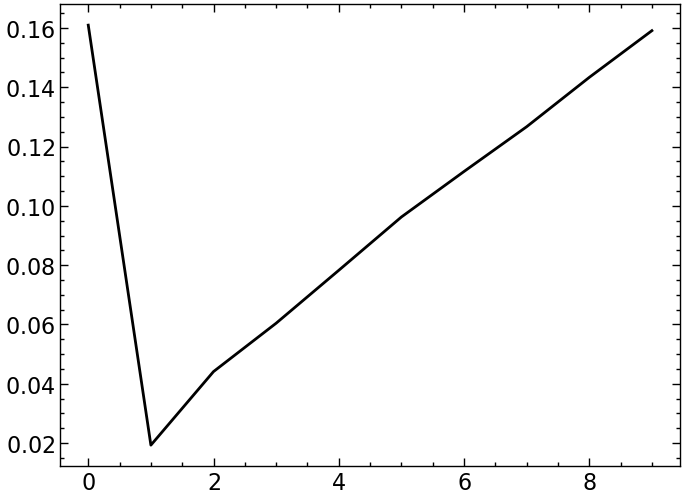

In [15]:
idx_result, idx_50Mpc, d2d, d3d = cat_cdfs.search_around_sky(cat_result, 10*u.arcsec)
h, bin_edges = np.histogram(d2d.to(u.arcsec).value, bins=10)
# plot the cumulative function
#plt.plot(bin_edges[:-1], np.cumsum(h/np.sum(h*np.diff(bin_edges))), c='blue')
plt.plot(bin_edges[:-1], h/np.sum(h*np.diff(bin_edges)), c='k')

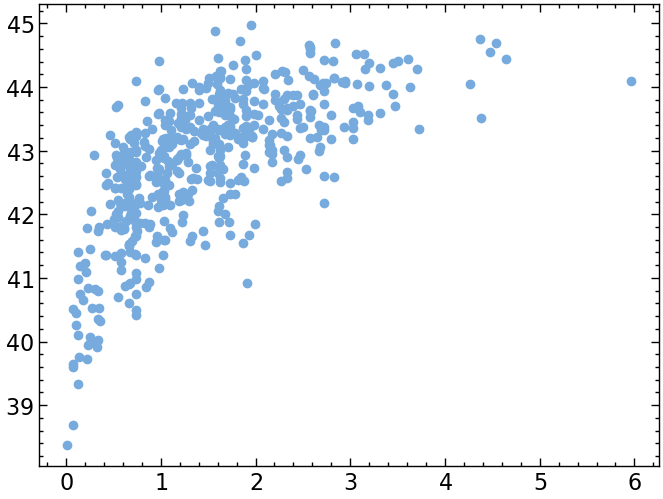

In [16]:
plt.scatter(tcdfs['redshift'][tcdfs['log_lx_csc']>0], tcdfs['log_lx_csc'][tcdfs['log_lx_csc']>0])

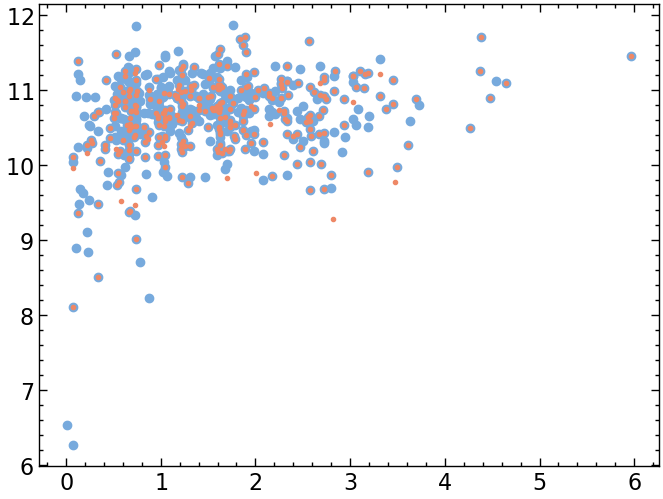

In [17]:
plt.scatter(tcdfs['redshift'][tcdfs['log_lx_csc']>0], np.log10(tcdfs['Mstar_best'])[tcdfs['log_lx_csc']>0])

plt.scatter(tcdfs['redshift'][tcdfs['log_lx_csc']>0], np.log10(tcdfs['Mstar_agn'])[tcdfs['log_lx_csc']>0], marker='.')

In [18]:
os.environ["OMP_NUM_THREADS"] = "1"

#from multiprocessing import Pool
from multiprocess import Pool

from multiprocessing import cpu_count
ncpu = cpu_count() - 1
print("{0} CPUs".format(ncpu))

47 CPUs


In [19]:
def log_likelihood(theta, x, y, xerr, yerr, z, logSFR, logSFRerr, p_obs, r_match):

    # parameters to be fit
    log_ms0, delta1, ep, log_lam_min, log_lam_0, log_f, f_a, delta, theta2, P_XRB = theta


    #n = 2 # n + 1 = number of nodes
    z_max = 6
    #z_ks = [10**(0.5*np.log10(1 + z_max) + 0.5*np.log10(1 + z_max)*np.cos((2*k + 1)/(2*(n + 1)) * np.pi)) - 1 for k in range(n)]
    #x_ks = [2*np.log10(1 + z_k)/np.log10(1 + z_max) - 1 for z_k in z_ks]
    #c_0 = 2/(n+1) * np.sum(logK0 * 1 + logK1 * x1 + logK2 * (2*x2**2 - 1))
    
    mask_det = yerr > 0

    #x_bh = 7.43 + 1.61*(x - np.log10(3e10)) # 0.81
    x_bh = 6.70 + 1.61*(x - np.log10(3e10)) # Late-type (AGN)

    L_HX = 9.05*1e28 * 10**x + 1.62*1e39 * 10**logSFR
    L_gas = 8.3*1e38 * 10**logSFR
    #b = 2*n - 1/3
    #alpha = ((2*r_match)/d25)
    logL_SF = np.log10(L_HX + L_gas) #+ np.log10(gammainc(2*n, b*alpha**(1/n)) / gammainc(2*n, b))
    
    BC = 1 # Bolometric correction
    log_lam = y + BC - 38.2 - x_bh #- logL_SF # residual
    lam = 10**log_lam
    #lam_s = 10**log_lam_s
    #lam_s = 1e-2 ###
    lam0 = 10**log_lam_0
    
    if log_lam_min > np.min(log_lam[mask_det]):
        return -np.inf, np.zeros_like(y[mask_det]), np.zeros_like(y[mask_det])
    
    log_lam_max = np.max(log_lam[mask_det])

    dlog_lam = 0.1
    dlog_lam_int = 0.1
    log_lam_eval = np.arange(log_lam_min, log_lam_max + dlog_lam, dlog_lam)
    log_lam_int = np.arange(-6, log_lam_max + 2 + dlog_lam, dlog_lam_int) #
    lam_eval = 10**log_lam_eval
    lam_int = 10**log_lam_int
    dlam_eval = np.diff(lam_eval)
    dlam_int = np.diff(lam_int)
    
    s2 = np.full(len(mask_det), np.exp(2*log_f)**2 + (1.61*xerr)**2)
    s2[mask_det] = yerr[mask_det]**2 + np.exp(2*log_f)**2 + (1.61*xerr[mask_det])**2

    # Either the source is an XRB or a BH
    # Try making the scatter here a free parameter
    s2_XRB = np.full(len(mask_det), (0.4)**2 + xerr**2)
    s2_XRB[mask_det] = (0.4)**2 + (yerr[mask_det])**2 + (xerr[mask_det])**2 + (logSFRerr[mask_det])**2
    pdf_XRB = st.norm.pdf(y[mask_det] - logL_SF[mask_det], scale=np.sqrt(s2_XRB[mask_det]))

    # p = f * N + (1 - p) delta 
    _f_BHOF = f_x(x, log_ms0, f_a, delta, theta2)

    delta1 = delta1 + 1

    # Detections
    # pdf
    # https://arxiv.org/pdf/1503.01120
    # The likelihood is evaluated over a grid of redshfits

    # LADE luminosity evolution
    log_lam_sz = log_lam_0 #- np.log10(((1+zc_star)/(1+zi))**p1 + ((1+zc_star)/(1+zi))**p2)
    lam_sz = 10**log_lam_sz

    # PDF
    pdf_pl_int = ( (lam_int/lam_sz)**delta1 + (lam_int/lam_sz)**(delta1+ep) )**(-1)
    pdf_int = fftconvolve(pdf_pl_int, st.norm.pdf(np.arange(-5, 5, dlog_lam_int), loc=0, scale=np.sqrt(np.mean(s2[mask_det]))), mode='same') # np.sqrt(np.mean(s2[mask_det])))
    # at small values, the extrapolation gets wacky
    f = interp1d(log_lam_int, pdf_int, bounds_error=False, fill_value='extrapolate')
    # 
    def f_extrap(ll, l1=-5.5, l2=0.0):
        mask_pl = (ll > l1) & (ll < l2)
        # Get the lower & upper -slopes
        x1 = np.array([-5.5, -5.0, -4.5])
        x2 = np.array([-1.0, -0.5, 0.0])
        pl1 = interp1d(x1, np.log10(f(x1)), fill_value='extrapolate')
        pl2 = interp1d(x2, np.log10(f(x2)), fill_value='extrapolate')
        return np.concatenate([10**pl1(ll[ll <= l1]), f(ll[mask_pl]), 10**pl2(ll[ll >= l2])])

    #  density evolution
    #logK = 0 + d * (1 + zi)
    # https://docs.scipy.org/doc//numpy-1.9.0/reference/generated/numpy.polynomial.chebyshev.chebval.html#numpy.polynomial.chebyshev.chebval
    #xi = 2*np.log10(1 + zi)/np.log10(1 + z_max) - 1
    #logK = np.polynomial.chebyshev.chebval(xi, c_n)
    #K = 10**logK
    # 
    pdf_eval = f_extrap(log_lam_eval) # * K here?
    # Normalize
    C = 1/trapezoid(pdf_eval, dx=dlam_eval)
    pdf_eval = C * pdf_eval
    # Evaluate
    f = interp1d(log_lam_eval, pdf_eval)
    ###########
    pdf = f(log_lam[mask_det]) # no redshift evolution
    ############

    ### DEBUG ###
    #plt.loglog(lam_int, pdf_int)
    #plt.show()
    #plt.loglog(lam_int, C * pdf_pl_int)
    #plt.show()
    #plt.loglog(lam_eval, pdf_eval)
    #plt.show()
    ### DEBUG ###

    # Censored
    # cdf
    cdf_eval = cumulative_trapezoid(pdf_eval, dx=dlam_eval, initial=0)
    f = interp1d(log_lam_eval, cdf_eval, bounds_error=False, fill_value=(0.0, 1.0))
    ###########
    cdf = f(log_lam[~mask_det])
    ###########

    cdf_XRB = st.norm.cdf(y[~mask_det] - logL_SF[~mask_det], scale=np.sqrt(s2_XRB[~mask_det]))
    #P_XRB = 0
    # Mixture model
    # https://dfm.io/posts/mixture-models/

    pdf[pdf==0] = 1e-12
    
    p_det = p_obs[mask_det] * ((1 - P_XRB) * _f_BHOF[mask_det] * pdf + P_XRB * pdf_XRB)
    p_cens = p_obs[~mask_det] * ((1 - P_XRB) * (_f_BHOF[~mask_det] * cdf + 1 - _f_BHOF[~mask_det]) + P_XRB * 1)
    #print(pdf[np.isinf(np.log(p_det))])
    #print(cdf[np.isinf(np.log(p_cens))])
    #return

    # Total likelihood
    ll = np.sum(np.log(p_det)) + np.sum(np.log(p_cens))

    ll_fg = np.log(p_obs[mask_det] * ((1 - P_XRB) * _f_BHOF[mask_det] * pdf))
    ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)

    #print('ll:', ll)
    
    return ll, ll_fg, ll_bg

In [ ]:
def make_bhmf(flat_samples):

        fig2, ax2 = plt.subplots(1, 1, figsize=(6, 4.0))
        ax2.set_xscale('log')
        ax2.set_yscale('log')

        # grid
        dlogm = .1
        logms = np.arange(2.0, 14.5, dlogm)
        ms = 10**logms
        dms = np.diff(ms)

        Nsamp = 8000 #len(flat_samples) #2000 

        gsmf = np.zeros([len(logms), Nsamp])
        gsmf_blue = np.zeros([len(logms), Nsamp])
        gsmf_red = np.zeros([len(logms), Nsamp])

        # BHOF should not depend on galaxy color type
        bhmf16 = np.zeros([len(logms), Nsamp])
        bhmf84 = np.zeros([len(logms), Nsamp])

        bhmf_blue = np.zeros([len(logms), Nsamp])
        bhmf_red = np.zeros([len(logms), Nsamp])
        foccs = np.zeros([len(logms), Nsamp])


        for i in range(Nsamp):

        # total BH mass function is dominated by early population
        # GSH20, early-type / E, limits
        alpha_red = np.random.normal(7.89, 0.09, size=1)
        beta_red = np.random.normal(1.33, 0.12, size=1)
        sigma_red = np.random.normal(0.2, 0.02, size=1)
        logms0_red = np.log10(3*1e10)

        # grid
        logmb_red = alpha_red + beta_red*(logms - logms0_red)
        mb_red = 10**logmb_red
        dmb_red = np.diff(mb_red)

        # BH mass - stellar mass relation
        # RV15 / similar to GSH20, early-type
        #alpha_blue = np.random.normal(7.45, 0.08, size=1)
        #beta_blue = np.random.normal(1.05, 0.11, size=1)
        #sigma_blue = np.random.normal(0.55-0.3, 0.02, size=1) # Assume 10% error on scatter - 0.3
        #logms0_blue = 11

        alpha_blue = np.random.normal(6.70, 0.13, size=1)
        beta_blue = np.random.normal(1.61, 0.12, size=1)
        sigma_blue = np.random.normal(0.2, 0.02, size=1) # Assume 10% error on scatter - 0.3
        logms0_blue = np.log10(3*1e10)

        # grid
        logmb_blue = alpha_blue + beta_blue*(logms - logms0_blue)
        mb_blue = 10**logmb_blue
        dmb_blue = np.diff(mb_blue)

        gsmf[:,i] = logGSMF(ms)
        gsmf_blue[:,i] = logGSMF_blue(ms)
        gsmf_red[:,i] = logGSMF_red(ms)

        # Convolve
        xii = flat_samples[i,1]
        theta2i = flat_samples[i,2]
        x50i = flat_samples[i,0]
        foccs[:,i] = 1/(1 + xii * np.exp(-theta2i*(logms - x50i)))**(1/xii)

        bhmf_blue[:,i] = 1 * np.array([np.trapz(gsmf_blue[:,i] * st.norm.pdf(logmbi-logms, loc=logmb_blue-logms, scale=sigma_blue)*dlogm) for logmbi in logmb_blue])
        bhmf_red[:,i] = 1 * np.array([np.trapz(gsmf_red[:,i] * st.norm.pdf(logmbi-logms, loc=logmb_red-logms, scale=sigma_red)*dlogm) for logmbi in logmb_red])


        ###

        bhmf16 = np.interp(mb_red, mb_blue, np.interp(logmb_blue, logms, np.percentile(foccs, 16, axis=1)) * np.percentile(bhmf_blue, 16, axis=1)) + np.interp(mb_red, mb_red, np.interp(logmb_red, logms, np.percentile(foccs, 16, axis=1)) * np.percentile(bhmf_red, 16, axis=1))
        bhmf84 = np.interp(mb_red, mb_blue, 1 * np.percentile(bhmf_blue, 84, axis=1)) + np.interp(mb_red, mb_red, 1 * np.percentile(bhmf_red, 84, axis=1))

        bhmf5 = np.interp(mb_red, mb_blue, np.interp(logmb_blue, logms, np.percentile(foccs, 5, axis=1)) * np.percentile(bhmf_blue, 5, axis=1)) + np.interp(mb_red, mb_red, np.interp(logmb_red, logms, np.percentile(foccs, 5, axis=1)) * np.percentile(bhmf_red, 5, axis=1))
        bhmf95 = np.interp(mb_red, mb_blue, 1 * np.percentile(bhmf_blue, 95, axis=1)) + np.interp(mb_red, mb_red, 1 * np.percentile(bhmf_red, 95, axis=1))

        bhmf3 = np.interp(mb_red, mb_blue, np.interp(logmb_blue, logms, np.percentile(foccs, 100-99.7, axis=1)) * np.percentile(bhmf_blue, 100-99.7, axis=1)) + np.interp(mb_red, mb_red, np.interp(logmb_red, logms, np.percentile(foccs, 100-99.7, axis=1)) * np.percentile(bhmf_red, 100-99.7, axis=1))



        ax2.fill_between(mb_red, bhmf84, bhmf16, color=color, alpha=0.25, lw=0, label=r'this work')
        ax2.fill_between(mb_red, bhmf95, bhmf5, color='k', alpha=0.15, lw=0) #, label=r'this work (2$\sigma$)')
        ax2.fill_between(mb_red, bhmf3, bhmf5, color='k', alpha=0.05, lw=0) #, label=r'this work (3$\sigma$)')

        # Active fraction too
        #ax2.fill_between(mb[:-1], np.percentile(bhmf[:-1], 16, axis=1) * dlogm,
        #                 np.percentile(bhmf[:-1], 84, axis=1) * dlogm)

        #x_eval_tde = np.logspace(5.1, 8.2, 10)
        #ax2.plot(x_eval_tde, 5e-4*(x_eval_tde/1e7)**-0.25, linestyle='-.', color='green', label='TDEs (Y23)', alpha=0.8)

        ax2.set_ylim(1e-7, 1e-1)
        ax2.set_xlim(1e2, 4e10)
        ax2.set_xlabel(r'$M_{\rm{BH}}\ (M_{\odot})$')
        ax2.set_ylabel(r'$\phi_{M_{\rm{BH}}}$ (dex$^{-1}$ Mpc$^{-3})$')

        dat = ascii.read('trinity.txt')
        ax2.plot(dat['col1'], -dat['col2'], linestyle='solid',
                color='lightblue', label='TRINITY (Z23)', lw=2.5, zorder=-1, alpha=0.6)


        color='k'
        # already put dm above!!
        ax2.plot(mb_blue[:-1], np.percentile(bhmf_blue[:-1], 50, axis=1), # * dlogm,
                color=color, lw=3, linestyle='solid', alpha=0.4) #, label='late-type (this work)')
        ax2.plot(mb_red[:-1], np.percentile(bhmf_red[:-1], 50, axis=1), # * dlogm,
                color=color, lw=3, linestyle='dashed', alpha=0.4) #, label='early-type (this work)')

        # Axis
        locmaj = matplotlib.ticker.LogLocator(base=10,numticks=14) 
        ax2.xaxis.set_major_locator(locmaj)
        locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9),numticks=14)
        ax2.xaxis.set_minor_locator(locmin)
        ax2.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        ax2.tick_params(axis='x', which='major', pad=7)

        locmaj = matplotlib.ticker.LogLocator(base=10,numticks=14) 
        ax2.yaxis.set_major_locator(locmaj)
        locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9),numticks=14)
        ax2.yaxis.set_minor_locator(locmin)
        ax2.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        ax2.tick_params(axis='y', which='major', pad=7)

        ax2.legend(fontsize=8.5, loc='lower left', ncol=1) #, bbox_to_anchor=(1, 0.5))

        # seperate legend for this work

        fig2.tight_layout()
        fig2.savefig('bhmfcdfs.pdf', dpi=300)

(6, 2)


  3%|▎         | 26/1000 [00:04<02:47,  5.82it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:131: RuntimeWarning: invalid value encountered in log
  ll = np.sum(np.log(p_det)) + np.sum(np.log(p_cens))
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
  3%|▎         | 27/1000 [00:04<02:47,  5.82it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:131: RuntimeWarning: invalid value encountered in log
  ll = np.sum(np.log(p_det)) + np.sum(np.log(p_cens))
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
  3%|▎         | 31/1000 [00:05<02:46,  5.83it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:131: RuntimeWarning: invalid value encountered in log
  ll = np.sum(np.log(p_det)) + np.sum(np.log(p_cens))
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: Runtim

(3200, 10)
95% CI:  9.284314197189039


  4%|▍         | 39/1000 [00:06<02:36,  6.12it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:131: RuntimeWarning: invalid value encountered in log
  ll = np.sum(np.log(p_det)) + np.sum(np.log(p_cens))
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
  4%|▍         | 40/1000 [00:06<02:36,  6.15it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:131: RuntimeWarning: invalid value encountered in log
  ll = np.sum(np.log(p_det)) + np.sum(np.log(p_cens))
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
  4%|▍         | 45/1000 [00:07<02:34,  6.17it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:131: RuntimeWarning: invalid value encountered in log
  ll = np.sum(np.log(p_det)) + np.sum(np.log(p_cens))
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: Runtim

(3200, 10)


/tmp/tmp.Yaihao9eBx/ipykernel_338104/4190882850.py:226: RuntimeWarning: invalid value encountered in divide
  frac_det = hist_det/hist_all


95% CI:  9.889775500896025


  4%|▍         | 44/1000 [00:04<01:34, 10.12it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:131: RuntimeWarning: invalid value encountered in log
  ll = np.sum(np.log(p_det)) + np.sum(np.log(p_cens))
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
  5%|▍         | 48/1000 [00:04<01:33, 10.14it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:131: RuntimeWarning: invalid value encountered in log
  ll = np.sum(np.log(p_det)) + np.sum(np.log(p_cens))
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
  5%|▌         | 52/1000 [00:05<01:33, 10.16it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:131: RuntimeWarning: invalid value encountered in log
  ll = np.sum(np.log(p_det)) + np.sum(np.log(p_cens))
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: Runtim

(3200, 10)


/tmp/tmp.Yaihao9eBx/ipykernel_338104/4190882850.py:226: RuntimeWarning: invalid value encountered in divide
  frac_det = hist_det/hist_all


95% CI:  10.236270651913346


  4%|▍         | 40/1000 [00:03<01:22, 11.70it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:131: RuntimeWarning: invalid value encountered in log
  ll = np.sum(np.log(p_det)) + np.sum(np.log(p_cens))
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
  4%|▍         | 42/1000 [00:03<01:21, 11.74it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:131: RuntimeWarning: invalid value encountered in log
  ll = np.sum(np.log(p_det)) + np.sum(np.log(p_cens))
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:131: RuntimeWarning: invalid value encountered in log
  ll = np.sum(np.log(p_det)) + np.sum(np.log(p_cens))
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_b

(3200, 10)


/tmp/tmp.Yaihao9eBx/ipykernel_338104/4190882850.py:216: RuntimeWarning: overflow encountered in power
  foccs[j,:] = 1/(1 + s[-3] * np.exp(-s[-2]*(x_eval - s[0])))**(1/s[-3])
/tmp/tmp.Yaihao9eBx/ipykernel_338104/4190882850.py:226: RuntimeWarning: invalid value encountered in divide
  frac_det = hist_det/hist_all


95% CI:  10.57529421091154


  2%|▏         | 20/1000 [00:01<01:18, 12.52it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
  2%|▏         | 22/1000 [00:01<01:17, 12.54it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np

(3200, 10)


/tmp/tmp.Yaihao9eBx/ipykernel_338104/4190882850.py:216: RuntimeWarning: overflow encountered in power
  foccs[j,:] = 1/(1 + s[-3] * np.exp(-s[-2]*(x_eval - s[0])))**(1/s[-3])
/tmp/tmp.Yaihao9eBx/ipykernel_338104/4190882850.py:226: RuntimeWarning: invalid value encountered in divide
  frac_det = hist_det/hist_all


95% CI:  11.463075492238401


  2%|▏         | 18/1000 [00:01<01:19, 12.34it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
  2%|▏         | 20/1000 [00:01<01:19, 12.31it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
  2%|▏         | 22/1000 [00:01<01:19, 12.33it/s]/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarning: invalid value encountered in log
  ll_bg = np.log(p_obs[mask_det] * P_XRB * pdf_XRB)
/tmp/tmp.Yaihao9eBx/ipykernel_338104/2125998379.py:134: RuntimeWarni

(3200, 10)
95% CI:  11.461605823784812


/tmp/tmp.Yaihao9eBx/ipykernel_338104/4190882850.py:216: RuntimeWarning: overflow encountered in power
  foccs[j,:] = 1/(1 + s[-3] * np.exp(-s[-2]*(x_eval - s[0])))**(1/s[-3])
/tmp/tmp.Yaihao9eBx/ipykernel_338104/4190882850.py:226: RuntimeWarning: invalid value encountered in divide
  frac_det = hist_det/hist_all


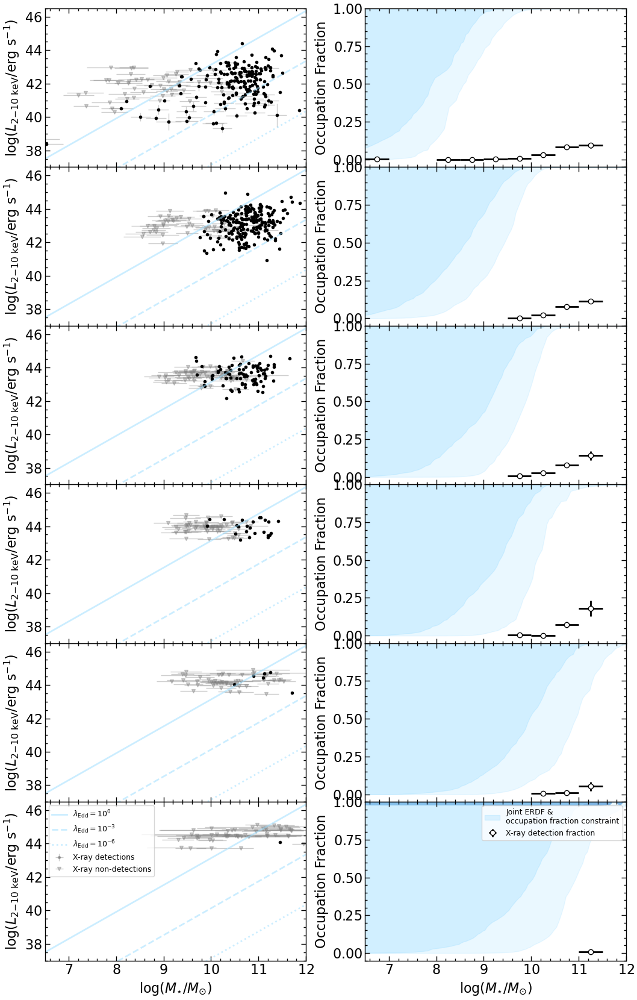

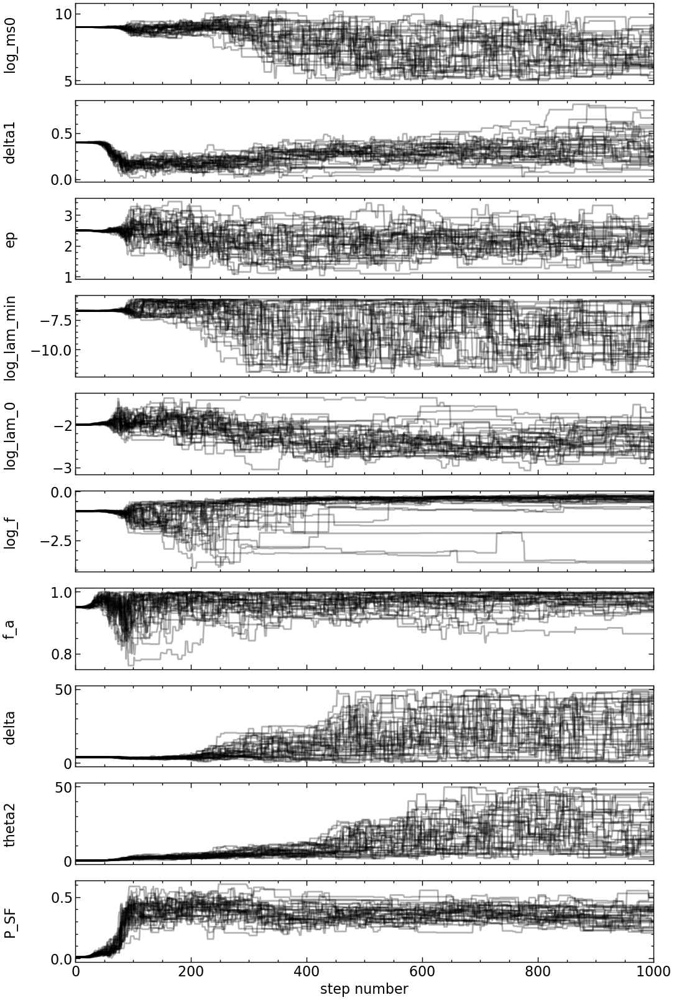

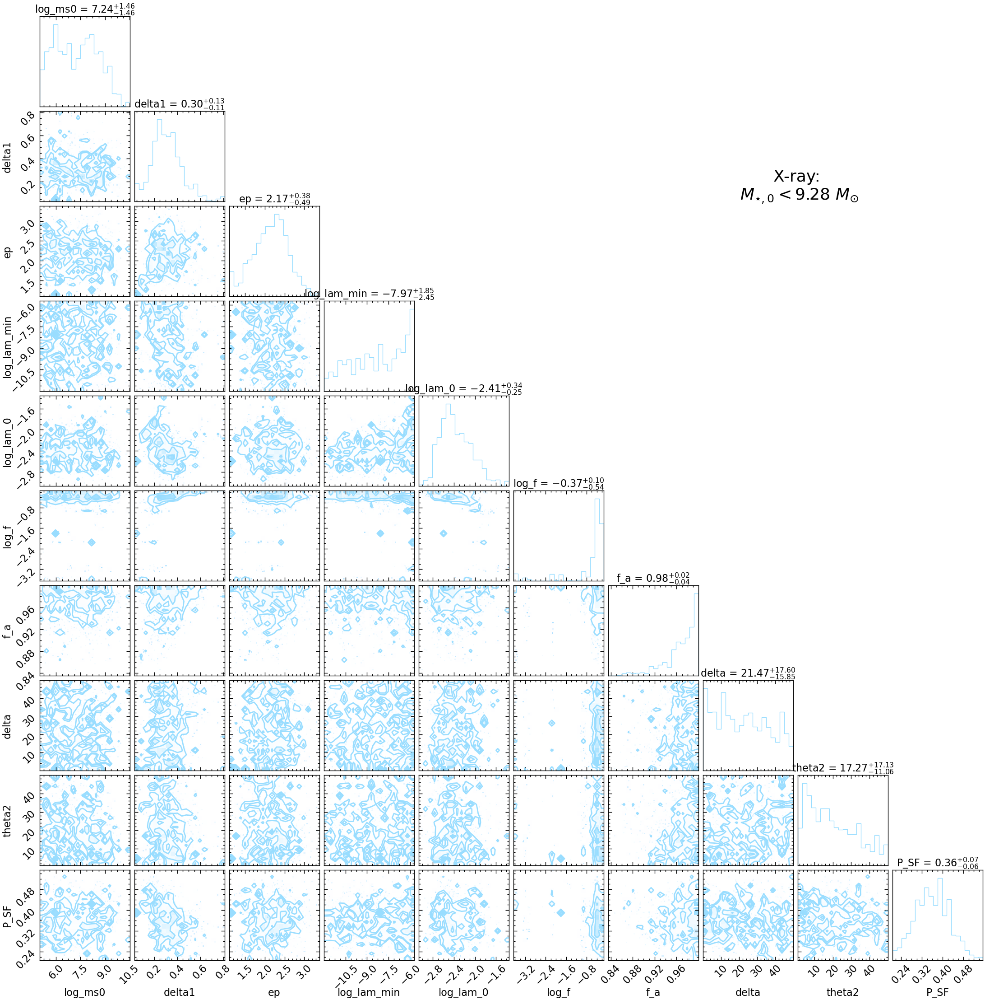

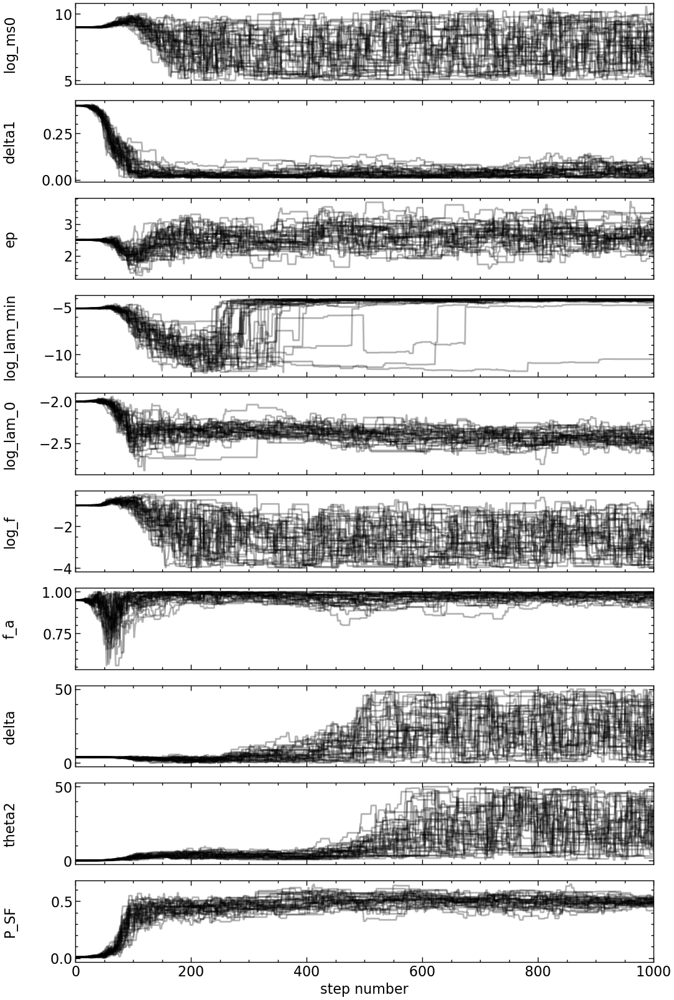

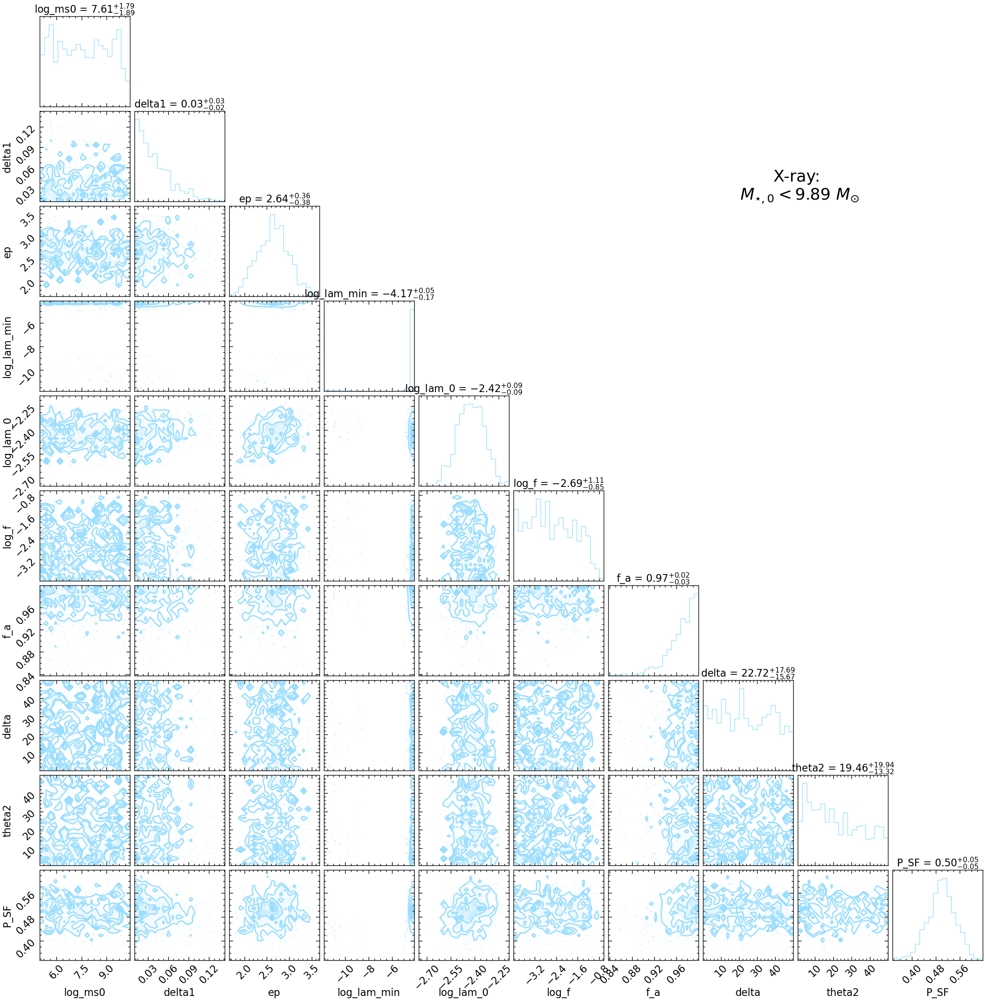

...

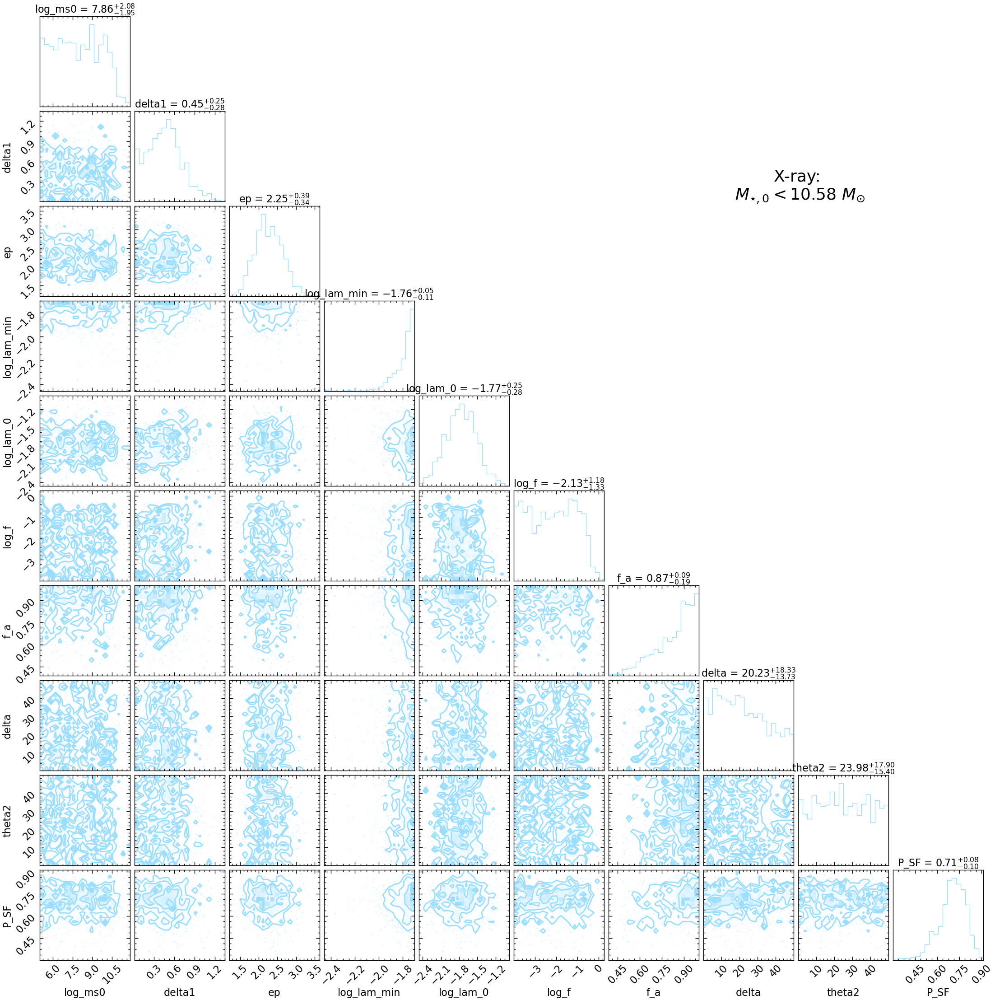

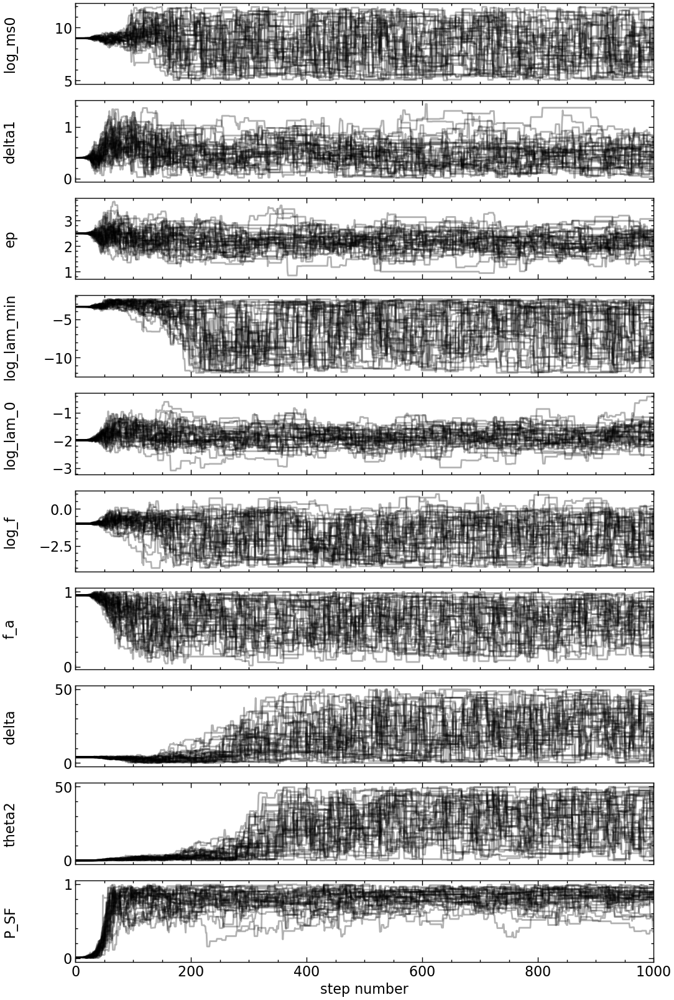

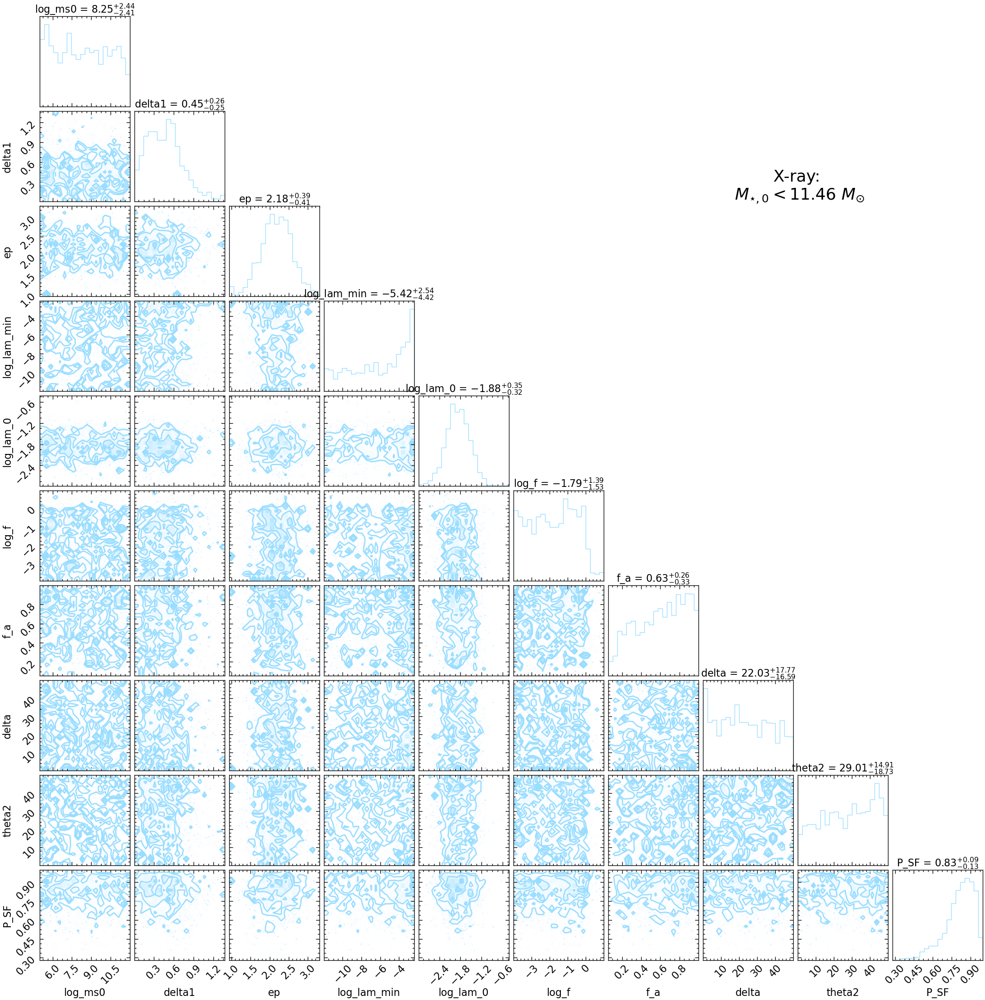

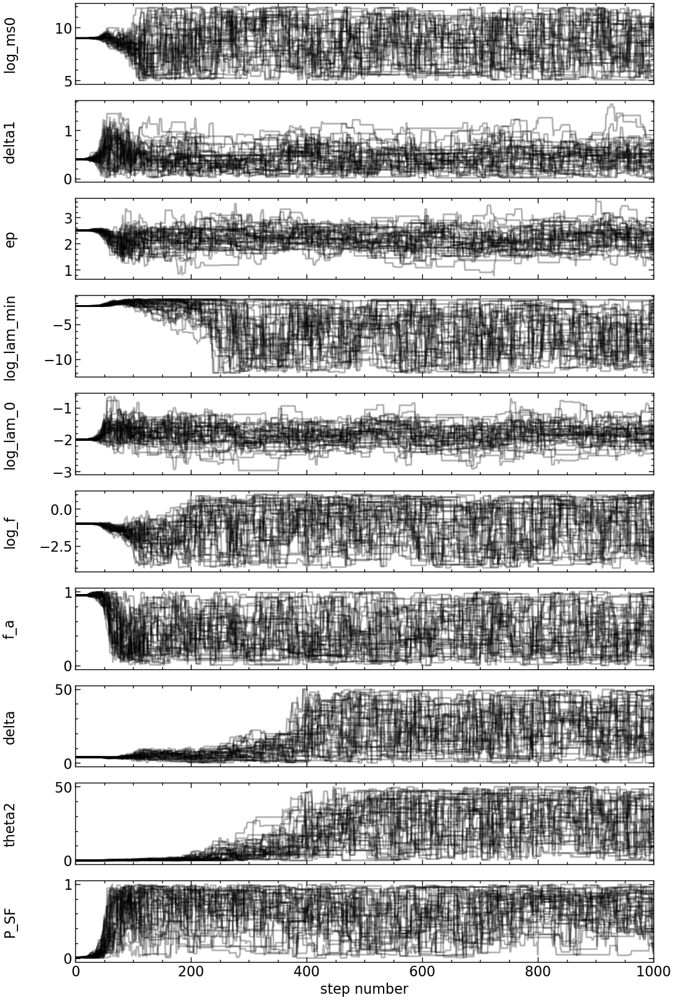

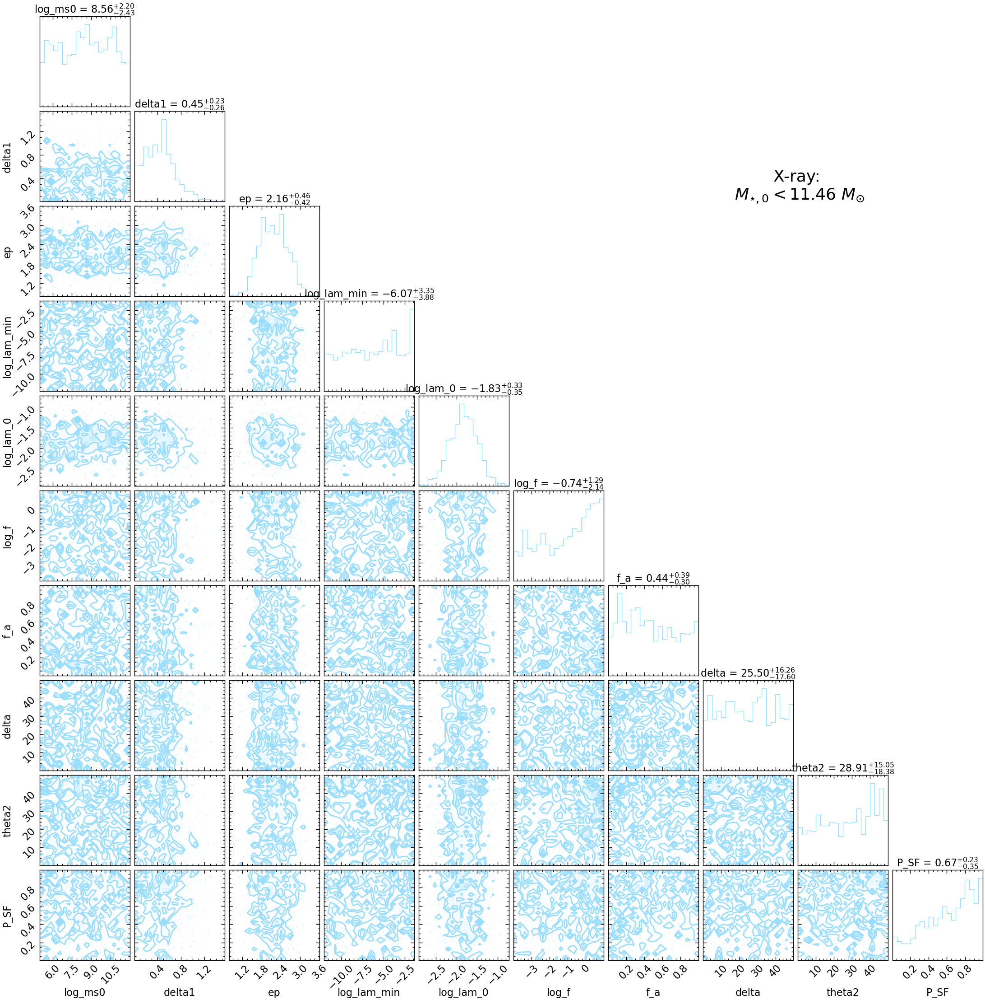

In [20]:
nsamp=1000 # 2000
nburn=800 # 600

dzbin = 1.0
z_max = 5
zbins = np.arange(0, z_max+dzbin, dzbin)

fig, axes = plt.subplots(len(zbins), 2, figsize=(11, 2.8*len(zbins)), sharex=True)
print(axes.shape)

for i, zi in enumerate(zbins):

    _z = tcdfs['redshift'].data.data.copy()
    maskz = (zi < _z) & (_z < zi+dzbin)

    _y = tcdfs['_log_lx'].data.copy()[maskz]
    _yerr = tcdfs['_log_lx_err'].data.copy()[maskz]

    # sources with no observation should have an upper limit set by ROSAT or EROSITA
    # Use whichever limit is more constraining
    #yerr[y==-1] = -1.0

    _x = np.log10(tcdfs['Mstar_best'].data.data).copy()[maskz]
    _xerr = np.sqrt(((0.434*tcdfs['Mstar_best_err']/tcdfs['Mstar_best'].data.data).copy())**2 + 0.2**2)[maskz]

    _z = _z[maskz]

    ## TODO: ADD these quantities to the full table and use ROSAT flux limit for the non-detections

    mask = (_x != 1) & np.isfinite(_x) & np.isfinite(_y) & np.isfinite(_xerr) & np.isfinite(_yerr) & (_y > 0) 
    x = _x[mask]
    y = _y[mask]
    xerr = _xerr[mask]
    yerr = _yerr[mask]
    logsfr = np.log10(tcdfs['SFR_best'].data.data).copy()[maskz][mask]
    logsfrerr = np.log10(tcdfs['SFR_best_err'].data.data).copy()[maskz][mask]

    mask_nosfr = ~np.isfinite(logsfr)
    logsfr[mask_nosfr] = -6
    logsfrerr[mask_nosfr] = 0.1

    z = _z[mask]

    #dist = data_50Mpc['bestdist'].copy()[mask]
    #colortype = data_50Mpc['best_type'].copy()[mask]
    #d25 = data_50Mpc['d25'].copy()[mask]*60 # arcsec
    r_match = 1.0

    """
    mask_nod25 = ~np.isfinite(d25)
    # 2 R50 = R100
    # 2 R100 = d
    # Start with size-mass relation
    d25[mask_nod25 & (colortype=='early')] = 4 * 3.47*1e-5*(10**(x[mask_nod25 & (colortype=='early')]))**0.56 # 0.5 dex scatter
    d25[mask_nod25 & (colortype=='late')] = 4 * 0.1*(10**(x[mask_nod25 & (colortype=='late')]))**0.14 * (1 + 10**(x[mask_nod25 & (colortype=='late')])/(3.98*1e10))**(0.39 - 0.14) # 0.5 dex scatter
    d25[mask_nod25] = d25[mask_nod25] * cosmo.arcsec_per_kpc_proper(z_at_value(cosmo.comoving_distance, dist[mask_nod25]*u.Mpc)).value
    # Start with average value for galaxies without best type

    """
    n = np.full(len(x), 2.5)
    """
    n[colortype=='early'] = 4.0
    n[colortype=='late'] = 1.0
    """
    #print(n)

    #p_obs = np.clip(np.interp(x, np.log10(M), np.mean(completeness_50MGC, axis=1)), 1e-6, 1)

    p_obs = np.ones_like(x)

    plt.scatter(x, p_obs)

    ## INFERENCE

    color='C4'
    ylims=[None, None]

    #x_bh = 7.43 + 1.61*(x - np.log10(3e10)) # 0.81
    x_bh = 6.70 + 1.61*(x - np.log10(3e10)) # Late-type (AGN)
    BC = 1 # Bolometric correction
    log_lam = y + BC - 38.2 - x_bh # residual

    #     log_ms0,  delta1, ep,  log_lam_min,                 log_lam_0, log_f, f_a,  delta, theta2, P_XRB
    pos = [9.0,     0.4,    2.5,  np.min(log_lam[yerr > 0])-1, -2.0,      -1.0,  0.95, 4.0,   0.1,   0.01]

    labels = ['log_ms0', 'delta1', 'ep', 'log_lam_min', 'log_lam_0', 'log_f', 'f_a', 'delta', 'theta2', 'P_SF']

    pos = np.array(pos) + 1e-4 * np.random.randn(32, len(pos))
    nwalkers, ndim = pos.shape

    def log_prior(theta):
        log_ms0, delta1, ep, log_lam_min, log_lam_0, log_f, f_a, delta, theta2, P_XRB = theta
        
        # Power-Law priors
        if 5.0 < log_ms0 < 12.0 and 0.01 < delta1 < 2.0 and 0.0 < ep < 5.0 and -12.0 < log_lam_min < 0.0 and -5.0 < log_lam_0 < 0.0 and -4.0 < log_f < 1.0 and 0 < f_a < 1 and 0.01 < delta < 50 and 0.01 < theta2 < 50 and 0 < P_XRB < 1:
            return np.log(st.norm.pdf(delta1, 0.47, (0.42+0.20)/2)) + np.log(st.norm.pdf(ep, 2.22, (0.51+0.30)/2)) + np.log(st.norm.pdf(log_lam_0, -1.84, (0.37+0.30)/2))
        
        #print('out of bound')
        #print(list(zip(labels, theta)))
        return -np.inf

    # log probability global
    args_global = (x, y, xerr, yerr, z, logsfr, logsfrerr, p_obs, r_match)

    def log_probability(theta):
        x, y, xerr, yerr, z, logSFR, logSFRerr, p_obs, r_match = args_global
        lp = log_prior(theta)
        ll, ll_fg, ll_bg = log_likelihood(theta, x, y, xerr, yerr, z, logSFR, logSFRerr, p_obs, r_match)
        if not np.isfinite(lp) or not np.isfinite(ll):
            return -np.inf, np.zeros_like(y[yerr>0]), np.zeros_like(y[yerr>0])
        return lp + ll, ll_fg, ll_bg

    ncpu = 1

    if ncpu > 1:
        with Pool() as pool:
            sampler = emcee.EnsembleSampler(nwalkers, ndim, log_probability, pool=pool, moves=[
            (emcee.moves.DEMove(), 0.8),
            (emcee.moves.DESnookerMove(), 0.2),
        ],)
            sampler.run_mcmc(pos, nsamp, progress=True);
    else:
        sampler = emcee.EnsembleSampler(nwalkers, ndim, log_probability, moves=[
            (emcee.moves.DEMove(), 0.8),
            (emcee.moves.DESnookerMove(), 0.2),
        ],)
        sampler.run_mcmc(pos, nsamp, progress=True);

    norm = 0.0
    post_prob = np.zeros(len(x[yerr>0]))
    for j in range(sampler.chain.shape[1]):
        for k in range(sampler.chain.shape[0]):
            ll_fg, ll_bg = sampler.blobs[j][k]
            post_prob += np.exp(ll_fg - np.logaddexp(ll_fg, ll_bg))
            norm += 1
    post_prob /= norm

    # Plot
    fig_trace, axes_trace = plt.subplots(ndim, figsize=(12, 20), sharex=True)
    samples = sampler.get_chain()
    labels = ['log_ms0', 'delta1', 'ep', 'log_lam_min', 'log_lam_0', 'log_f', 'f_a', 'delta', 'theta2', 'P_SF']

    for j in range(ndim):
        ax = axes_trace[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes_trace[-1].set_xlabel("step number");

    #tau = sampler.get_autocorr_time()
    #print(tau)

    flat_samples = sampler.get_chain(discard=500, thin=5, flat=True)

    print(flat_samples.shape)

    #flat_samples[:,9] = np.exp(2*flat_samples[:,9]) # sigma

    # Medians
    fig_corner = corner.corner(flat_samples, labels=labels, color=color, show_titles=True)

    ####################################################################
    # Occupation figure

    #################fig, axes = plt.subplots(1, 2, figsize=(11, 3.5))
    #inds = np.random.randint(len(flat_samples), size=100)

    # Plot data
    mask_temp = z < 0.5
    x_eval = np.linspace(5, 15, 200)
    axes[i,0].scatter(x[(yerr > 0)][(post_prob > .95)], y[(yerr > 0)][(post_prob > .95)], marker='.', color='k', alpha=1)
    axes[i,0].errorbar(x[(yerr > 0) & mask_temp], y[(yerr > 0) & mask_temp], elinewidth=1,
                        xerr=xerr[(yerr > 0) & mask_temp], yerr=yerr[(yerr > 0) & mask_temp],
                        fmt=".k", capsize=0, alpha=0.2, label='X-ray detections')

    #axes[0].scatter(x[(yerr > 0)][(post_prob < .95)], y[(yerr > 0)][(post_prob < .95)], marker='s', color='k', alpha=1)
    axes[i,0].scatter(x[(yerr > 0)][(post_prob < .95)], y[(yerr > 0)][(post_prob < .95)], marker='.', color='k', alpha=1)

    # Pick random
    if len(y[yerr < 0]) > 50:
        #ind_rand = np.arange(len(y[yerr < 0]))
        ind_rand = np.random.choice(len(y[yerr < 0]), 50, replace=False)
    else:
        ind_rand = np.arange(len(y[yerr < 0]))

    axes[i,0].errorbar(x[yerr < 0][ind_rand], y[yerr < 0][ind_rand],
                        xerr=xerr[yerr < 0][ind_rand], elinewidth=1, markersize=5,
                        marker="v", linestyle="none", color="gray", alpha=0.4, capsize=0, zorder=-1, label='X-ray non-detections')
    #axes[i,0].legend(fontsize=14)
    axes[i,0].set_xlim([6.5, 12])
    axes[i,0].set_ylim([37, 46.5])
    axes[i,0].set_xlabel(r'$\log(M_{\star} / M_{\odot})$')
    axes[i,0].set_ylabel(r'$\log(L_{2{-}10\ {\rm{keV}}} / {\rm{erg}}\ {\rm{s}}^{-1})$')

    # Linear relation
    x_bh_eval = 6.70 + 1.61*(x_eval - np.log10(3e10)) # Late-type (AGN)
    BC = 1 # Bolometric correction
    y_eval = -BC + 38.2 + x_bh_eval

    axes[i,0].plot(x_eval, y_eval, color=color, alpha=0.5, zorder=2, label=r'$\lambda_{\rm{Edd}} = 10^{0}$')

    axes[i,0].plot(x_eval, y_eval-3, color=color, alpha=0.5, zorder=2, linestyle='dashed', label=r'$\lambda_{\rm{Edd}} = 10^{-3}$')

    axes[i,0].plot(x_eval, y_eval-6, color=color, alpha=0.5, zorder=2, linestyle='dotted', label=r'$\lambda_{\rm{Edd}} = 10^{-6}$')

    # Limits
    log_ms0_low = np.percentile(flat_samples[:,0], 95)
    log_ms0_high = np.percentile(flat_samples[:,0], 5)
    print('95% CI: ', log_ms0_low)

    # Occupation fraction
    foccs = np.zeros([len(flat_samples), len(x_eval)])
    for j, s in enumerate(flat_samples):
        foccs[j,:] = 1/(1 + s[-3] * np.exp(-s[-2]*(x_eval - s[0])))**(1/s[-3])
        #foccs[i,:] = 1/2*(1 + np.tanh(2.5**np.abs(8.9 - s[0]) * (x_eval - s[0])))

    axes[i,1].fill_between(x_eval, np.percentile(foccs, 16, axis=0), np.percentile(foccs, 84, axis=0), color=color, alpha=0.3,
                            label=r'Joint ERDF &'+'\n'+'occupation fraction constraint')
    axes[i,1].fill_between(x_eval, np.percentile(foccs, 5, axis=0), np.percentile(foccs, 95, axis=0), color=color, alpha=0.2)

    # Histogram
    hist_det, bin_edges = np.histogram(x[yerr>0], bins=np.arange(5, 12, 0.5))
    hist_all, bin_edges = np.histogram(x,  bins=np.arange(5, 12, 0.5))
    frac_det = hist_det/hist_all

    bincenter = (bin_edges[:-1] + bin_edges[1:]) / 2

    axes[i,1].errorbar(bincenter[hist_det>0], frac_det[hist_det>0], xerr=0.5/2,
                        yerr=st.binom.std(hist_all[hist_det>0], frac_det[hist_det>0])/hist_all[hist_det>0],
                        color="k", capsize=0, marker='o', mfc='w', linestyle='none', label='X-ray detection fraction')

    # Right panel
    axes[i,1].set_xlim([6.5, 12])
    axes[i,1].set_ylim([-0.05, 1])
    axes[i,1].set_ylabel(r"Occupation Fraction")

    fig_corner.text(.8, .8, 'X-ray: \n'+r'$M_{\star,0} < $'+f'{np.round(log_ms0_low,2)}'+r' $M_{\odot}$', ha='center', fontsize=26)

axes[i,1].set_xlabel(r"$\log(M_{\star} / M_{\odot})$")
axes[i,0].legend(loc='upper left', fontsize=9, frameon=True)
axes[i,1].legend(loc='upper right', fontsize=9, frameon=True)
fig.tight_layout()
fig.subplots_adjust(hspace=0)
fig.savefig(f'bhofcdfs.pdf', dpi=300)

## Black hole mass function

In [21]:
def logGSMF_blue(M_star):
    """
    Galaxy stellar mass function of the z ~ 0 blue+green galaxy population (single Schechter function)
    https://ui.adsabs.harvard.edu/abs/2012MNRAS.421..621B/abstract
    """
    M_br = 10**10.72
    phi = 0.71*1e-3
    alpha = -1.45
    phi = np.log(10) * np.exp(-M_star/M_br) * phi*(M_star/M_br)**(alpha+1)
    return phi

def logGSMF_red(M_star):
    """
    Galaxy stellar mass function of the z ~ 0 red galaxy population (double Schechter function)
    https://ui.adsabs.harvard.edu/abs/2012MNRAS.421..621B/abstract
    """
    M_br = 10**10.72
    phi1 = 3.25*1e-3
    phi2 = 0.08*1e-3
    alpha1 = -0.45
    alpha2 = -1.45
    phi = np.log(10) * np.exp(-M_star/M_br) * (phi1*(M_star/M_br)**(alpha1+1) + phi2*(M_star/M_br)**(alpha2+1))
    return phi

def logGSMF(M_star, size=1):
    """
    Galaxy stellar mass function of the z ~ 0 blue+green galaxy population (single Schechter function)
    https://ui.adsabs.harvard.edu/abs/2012MNRAS.421..621B/abstract
    """
    logM_br = 10.78
    dlogM_br = 0.01
    
    phi1 = 2.96*1e-3
    dphi1 = 0.40*1e-3
    
    phi2 = 0.63*1e-3
    dphi2 = 0.10*1e-3
    
    alpha1 = -0.62
    dalpha1 = 0.03
    
    alpha2 = -1.50
    dalpha2 = 0.01
    
    M_br = 10**np.random.normal(loc=logM_br, scale=dlogM_br, size=size)
    phi1 = np.random.normal(loc=phi1, scale=dphi1, size=size)
    
    phi2 = np.random.normal(loc=phi2, scale=dphi2, size=size)
    
    alpha1 = np.random.normal(loc=alpha1, scale=dalpha1, size=size)
    alpha2 = np.random.normal(loc=alpha2, scale=dalpha2, size=size)

    # dN/dlogM
    phi = np.log(10) * np.exp(-M_star/M_br) * (phi1*(M_star/M_br)**(alpha1+1) + phi2*(M_star/M_br)**(alpha2+1))
    
    return phi

In [22]:
np.min(log_lam[yerr > 0])-1

-2.3844010849031303

In [23]:
len(x)

504

In [24]:
logsfr

array([2.11908271, 2.80962853, 2.25738544, 2.09468241, 2.0805148 ,
       2.32839401, 3.05692277, 2.20465946, 1.96852283, 3.30399094,
       2.2714693 , 3.08728607, 1.59590707, 1.82753161, 2.13256978,
       2.62517976, 2.44863135, 2.14179081, 2.56310462, 2.18656968,
       2.82404042, 1.99480442, 2.51514021, 2.0639556 , 3.24418331,
       2.3481366 , 2.4878335 , 2.9927173 , 2.27536201, 1.4740707 ,
       1.67631228, 2.98085005, 1.33152   , 1.55997419, 1.9722107 ,
       2.89825774, 2.04213851, 1.54116575, 1.65000257, 1.74904792,
       1.94023071, 1.42723212, 1.89532512, 2.22438724, 2.51687626,
       1.51724195, 2.10691605, 1.6035833 , 1.91455686, 2.41462889,
       2.40940842, 3.1060675 , 1.98109348, 1.4232687 , 1.98113143,
       2.66402262, 1.93660005, 2.17738878, 2.24682678, 1.40468165,
       1.97431878, 1.48018719, 2.57884559, 1.3740601 , 1.4999063 ,
       1.67116153, 2.08525462, 3.10711294, 2.56505371, 1.71927989,
       1.60388621, 1.58324071, 2.14062413, 1.43498776, 2.03105